# **Sketch-to-Real Image Translation using Pix2Pix GAN on Facades Dataset**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Dataset Loading & Preprocessing


In [ ]:
import tensorflow_datasets as tfds

# Load the Facades dataset
dataset_name = "cycle_gan/facades"
dataset, info = tfds.load(dataset_name, with_info=True, as_supervised=True)

# Access correct keys
trainA = dataset['trainA']
trainB = dataset['trainB']
testA = dataset['testA']
testB = dataset['testB']
print(f"✅ Dataset Loaded! {info}")
print("✅ Dataset Loaded!")
print(f"TrainA Samples: {len(list(trainA))}")
print(f"TrainB Samples: {len(list(trainB))}")
print(f"TestA Samples: {len(list(testA))}")
print(f"TestB Samples: {len(list(testB))}")



Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/4 [00:00<?, ? splits/s]

Generating trainA examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cycle_gan/facades/incomplete.10LQSI_3.0.0/cycle_gan-trainA.tfrecord*...:  …

Generating trainB examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cycle_gan/facades/incomplete.10LQSI_3.0.0/cycle_gan-trainB.tfrecord*...:  …

Generating testA examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cycle_gan/facades/incomplete.10LQSI_3.0.0/cycle_gan-testA.tfrecord*...:   …

Generating testB examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/cycle_gan/facades/incomplete.10LQSI_3.0.0/cycle_gan-testB.tfrecord*...:   …

Dataset cycle_gan downloaded and prepared to /root/tensorflow_datasets/cycle_gan/facades/3.0.0. Subsequent calls will reuse this data.
✅ Dataset Loaded! tfds.core.DatasetInfo(
    name='cycle_gan',
    full_name='cycle_gan/facades/3.0.0',
    description="""
    A dataset consisting of images from two classes A and B (For example: horses/zebras, apple/orange,...)
    """,
    homepage='https://junyanz.github.io/CycleGAN/',
    data_dir='/root/tensorflow_datasets/cycle_gan/facades/3.0.0',
    file_format=tfrecord,
    download_size=33.51 MiB,
    dataset_size=34.83 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    nondeterministic_order=False,
    splits={
        'testA': <SplitInfo num_examples=106, num_shards=1>,
        'testB': <SplitInfo num_examples=106, num_shards=1>,
        'trainA': <Spli

In [ ]:
import tensorflow_datasets as tfds

dataset_name = "cycle_gan/facades"
dataset, info = tfds.load(dataset_name, with_info=True, as_supervised=True)

print(info)


tfds.core.DatasetInfo(
    name='cycle_gan',
    full_name='cycle_gan/facades/3.0.0',
    description="""
    A dataset consisting of images from two classes A and B (For example: horses/zebras, apple/orange,...)
    """,
    homepage='https://junyanz.github.io/CycleGAN/',
    data_dir='/root/tensorflow_datasets/cycle_gan/facades/3.0.0',
    file_format=tfrecord,
    download_size=33.51 MiB,
    dataset_size=34.83 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    nondeterministic_order=False,
    splits={
        'testA': <SplitInfo num_examples=106, num_shards=1>,
        'testB': <SplitInfo num_examples=106, num_shards=1>,
        'trainA': <SplitInfo num_examples=400, num_shards=1>,
        'trainB': <SplitInfo num_examples=400, num_shards=1>,
    },
    citation="""@article{DBLP:journals/corr/Z

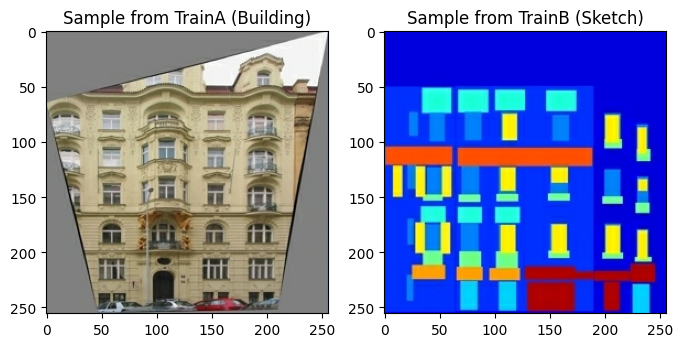

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf

# Extract train images
trainA = dataset['trainA']
trainB = dataset['trainB']

# Get one sample image
sample_A, _ = next(iter(trainA))  # Sample from trainA
sample_B, _ = next(iter(trainB))  # Sample from trainB

# Display images
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes[0].imshow(sample_A.numpy())
axes[0].set_title("Sample from TrainA (Building)")
axes[1].imshow(sample_B.numpy())
axes[1].set_title("Sample from TrainB (Sketch)")
plt.show()


In [ ]:
# Print number of images in each set
print("TrainA Samples:", len(list(dataset['trainA'])))
print("TrainB Samples:", len(list(dataset['trainB'])))
print("TestA Samples:", len(list(dataset['testA'])))
print("TestB Samples:", len(list(dataset['testB'])))


TrainA Samples: 400
TrainB Samples: 400
TestA Samples: 106
TestB Samples: 106


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

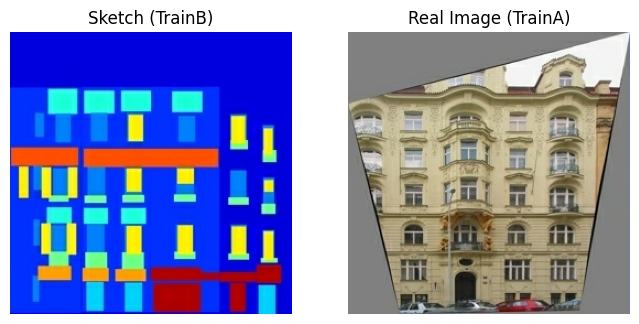

In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt

IMG_HEIGHT = 256
IMG_WIDTH = 256

# Load Facades dataset
dataset, info = tfds.load("cycle_gan/facades", with_info=True, as_supervised=True)
trainA = dataset["trainA"]
trainB = dataset["trainB"]

# Preprocessing function (resize + normalize)
def preprocess_image(image, _):  # Discard label
    image = tf.image.resize(image, [256, 256])
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    return image

trainA = dataset['trainA'].map(preprocess_image).batch(16)
trainB = dataset['trainB'].map(preprocess_image).batch(16)

train_dataset = tf.data.Dataset.zip((trainA, trainB))



# Display samples from TrainA and TrainB
# Display samples from TrainA and TrainB
for sketch_batch in trainB.take(1):
    for real_batch in trainA.take(1):
        plt.figure(figsize=(8, 4))

        plt.subplot(1, 2, 1)
        plt.imshow((sketch_batch[0].numpy() + 1) / 2)  # Normalize back to [0,1] for display
        plt.axis("off")
        plt.title("Sketch (TrainB)")

        plt.subplot(1, 2, 2)
        plt.imshow((real_batch[0].numpy() + 1) / 2)
        plt.axis("off")
        plt.title("Real Image (TrainA)")

        plt.show()


Model Architecture (Generator & Discriminator)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, LeakyReLU, ReLU, BatchNormalization, Dropout, Concatenate

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    block = tf.keras.Sequential()
    block.add(Conv2D(filters, size, strides=2, padding='same',
                     kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        block.add(BatchNormalization())

    block.add(LeakyReLU())

    return block

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    block = tf.keras.Sequential()
    block.add(Conv2DTranspose(filters, size, strides=2, padding='same',
                              kernel_initializer=initializer, use_bias=False))
    block.add(BatchNormalization())

    if apply_dropout:
        block.add(Dropout(0.5))

    block.add(ReLU())

    return block

def Generator():
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (128, 128, 64)
        downsample(128, 4),  # (64, 64, 128)
        downsample(256, 4),  # (32, 32, 256)
        downsample(512, 4),  # (16, 16, 512)
        downsample(512, 4),  # (8, 8, 512)
        downsample(512, 4),  # (4, 4, 512)
        downsample(512, 4),  # (2, 2, 512)
        downsample(512, 4),  # (1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (8, 8, 1024)
        upsample(512, 4),  # (16, 16, 1024)
        upsample(256, 4),  # (32, 32, 512)
        upsample(128, 4),  # (64, 64, 256)
        upsample(64, 4),   # (128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(3, 4, strides=2, padding='same',
                           kernel_initializer=initializer,
                           activation='tanh')  # (256, 256, 3)

    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)


In [ ]:
import tensorflow as tf

# Create a generator model instance
generator = Generator()

# Try a forward pass with a dummy input
dummy_input = tf.random.normal([1, 256, 256, 3])  # Batch size 1
output = generator(dummy_input)

print("✅ Generator Output Shape:", output.shape)


✅ Generator Output Shape: (1, 256, 256, 3)


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(
        layers.Conv2D(filters, size, strides=2, padding='same',
                      kernel_initializer=initializer, use_bias=not apply_batchnorm)
    )
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    result.add(layers.LeakyReLU())
    return result

def build_discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = layers.Input(shape=[256, 256, 3], name='input_image')
    tar = layers.Input(shape=[256, 256, 3], name='target_image')

    # Concatenate input and target (sketch + real/generated image)
    x = layers.Concatenate()([inp, tar])  # (bs, 256, 256, 6)

    down1 = downsample(64, 4, False)(x)    # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1)      # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2)      # (bs, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3)  # (bs, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1,
                         kernel_initializer=initializer,
                         use_bias=False)(zero_pad1)  # (bs, 31, 31, 512)

    batchnorm = layers.BatchNormalization()(conv)
    leaky_relu = layers.LeakyReLU()(batchnorm)

    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)  # (bs, 33, 33, 512)
    last = layers.Conv2D(1, 4, strides=1,
                         kernel_initializer=initializer)(zero_pad2)  # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)


In [ ]:
import tensorflow as tf

discriminator = build_discriminator()

dummy_input = tf.random.normal([1, 256, 256, 3])
dummy_target = tf.random.normal([1, 256, 256, 3])
output = discriminator([dummy_input, dummy_target])

print("✅ Discriminator Output Shape:", output.shape)


✅ Discriminator Output Shape: (1, 30, 30, 1)


In [ ]:
# Build Generator and Discriminator
generator = Generator()  # From generator.py
discriminator = build_discriminator()  # From discriminator.py

# ✅ Put this immediately after
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)


Training Loop with Checkpointing

In [ ]:
@tf.function
def train_step(input_image, target, generator, discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))


In [ ]:
import os

checkpoint_dir = "/content/drive/MyDrive/checkpoints"
os.makedirs(checkpoint_dir, exist_ok=True)

checkpoint = tf.train.Checkpoint(generator=generator,
                                 discriminator=discriminator,
                                 generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer)


In [ ]:
import matplotlib.pyplot as plt

def generate_and_show_sample(model, input_image, epoch):
    prediction = model(tf.expand_dims(input_image, 0), training=False)
    prediction = (prediction[0] + 1) / 2  # Rescale to [0, 1]

    plt.figure(figsize=(6, 6))
    plt.imshow(prediction)
    plt.axis("off")
    plt.title(f"Generated Image at Epoch {epoch}")
    plt.show()


In [ ]:
import tensorflow as tf

# Loss for Discriminator
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, generated_output):
    real_loss = loss_object(tf.ones_like(real_output), real_output)
    generated_loss = loss_object(tf.zeros_like(generated_output), generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss * 0.5

# Loss for Generator
'''def generator_loss(generated_output, gen_output, target):
    gan_loss = loss_object(tf.ones_like(generated_output), generated_output)
    # L1 loss encourages similarity to target
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (100 * l1_loss)
    return total_gen_loss'''
def generator_loss(gen_output, target):
    # L1 loss
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    # Adversarial loss
    adversarial_loss = loss_object(tf.ones_like(gen_output), gen_output)

    # Final loss
    total_gen_loss = adversarial_loss + (100 * l1_loss)
    return total_gen_loss



In [ ]:
@tf.function
def train_step(input_image, target, generator, discriminator, gen_optimizer, disc_optimizer):
    with tf.GradientTape(persistent=True) as tape:
        # Generate fake image
        gen_output = generator(input_image, training=True)

        # Discriminator outputs
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        # Losses
        gen_loss = generator_loss(gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    # Gradients
    gen_gradients = tape.gradient(gen_loss, generator.trainable_variables)
    disc_gradients = tape.gradient(disc_loss, discriminator.trainable_variables)

    # Apply gradients
    gen_optimizer.apply_gradients(zip(gen_gradients, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_gradients, discriminator.trainable_variables))

    return gen_loss, disc_loss


In [ ]:
import matplotlib.pyplot as plt

def generate_and_show_sample(generator, sketch_image, epoch_num):
    sketch_image = tf.expand_dims(sketch_image, 0)  # Add batch dim
    fake_real = generator(sketch_image, training=False)

    # Convert back from [-1, 1] to [0, 1]
    sketch_image = (sketch_image[0] + 1) / 2.0
    fake_real = (fake_real[0] + 1) / 2.0

    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(sketch_image.numpy())
    plt.title("Sketch Input")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(fake_real.numpy())
    plt.title("Generated (Fake Realistic)")
    plt.axis("off")

    # This will now also show the target if passed
    if hasattr(generate_and_show_sample, "real_image"):
        real_image = generate_and_show_sample.real_image
        real_image = (real_image + 1) / 2.0
        plt.subplot(1, 3, 3)
        plt.imshow(real_image.numpy())
        plt.title("Real Target")
        plt.axis("off")

    plt.suptitle(f"Epoch {epoch_num}")
    plt.show()


In [ ]:
def train(dataset, epochs):
    for epoch in range(epochs):
        print(f"\n🚀 Starting Epoch {epoch + 1}/{epochs}")
        for real, sketch in dataset:
            gen_loss, disc_loss = train_step(
                sketch, real,
                generator, discriminator,
                generator_optimizer, discriminator_optimizer
            )

            # Save first sample to display at end of epoch
            sample_sketch = sketch[14]
            sample_real = real[14]

        print(f"✅ Epoch {epoch + 1} - Gen Loss: {gen_loss:.4f}, Disc Loss: {disc_loss:.4f}")

        # Display: Sketch | Generated | Real side-by-side
        generate_and_show_sample.real_image = sample_real
        generate_and_show_sample(generator, sample_sketch, epoch + 1)
    checkpoint.save(file_prefix=os.path.join(checkpoint_dir, "ckpt"))
    print(f"💾 Checkpoint saved at epoch {epoch + 1}")


🚀 Starting Epoch 1/50
✅ Epoch 1 - Gen Loss: 13.6281, Disc Loss: 0.0091


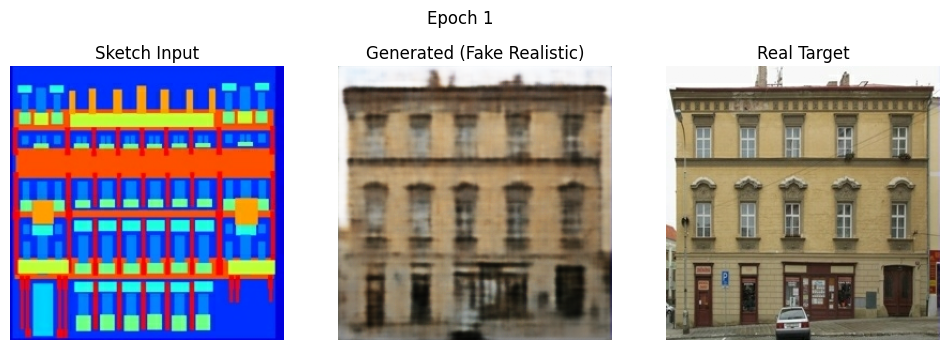


🚀 Starting Epoch 2/50
✅ Epoch 2 - Gen Loss: 13.5766, Disc Loss: 0.0046


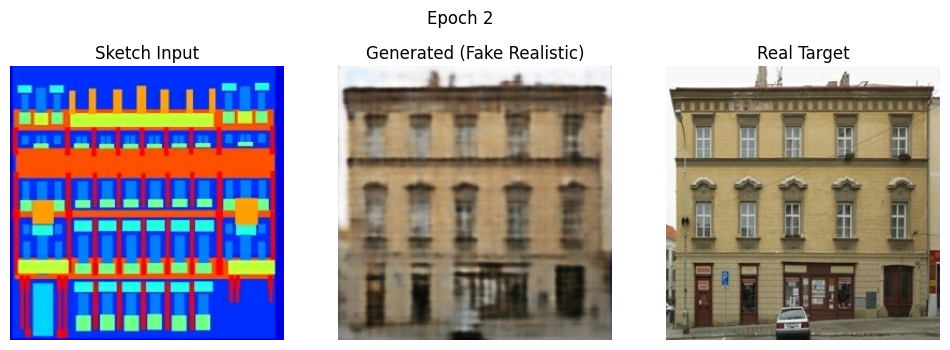


🚀 Starting Epoch 3/50
✅ Epoch 3 - Gen Loss: 13.6383, Disc Loss: 0.0036


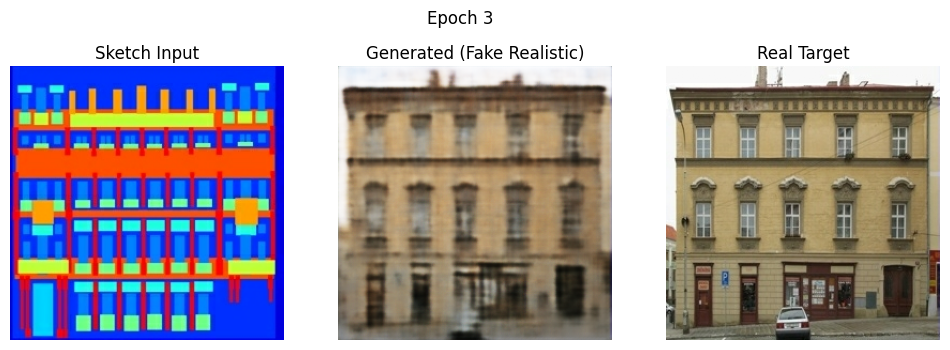


🚀 Starting Epoch 4/50
✅ Epoch 4 - Gen Loss: 13.8263, Disc Loss: 0.0026


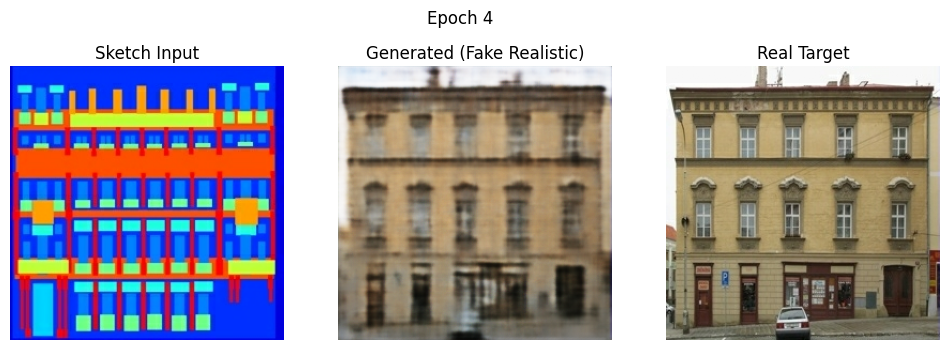


🚀 Starting Epoch 5/50
✅ Epoch 5 - Gen Loss: 13.7678, Disc Loss: 0.0032


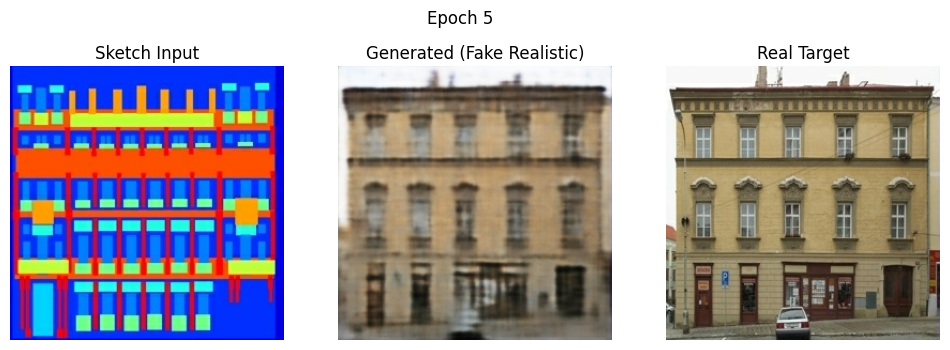


🚀 Starting Epoch 6/50
✅ Epoch 6 - Gen Loss: 14.0170, Disc Loss: 0.0023


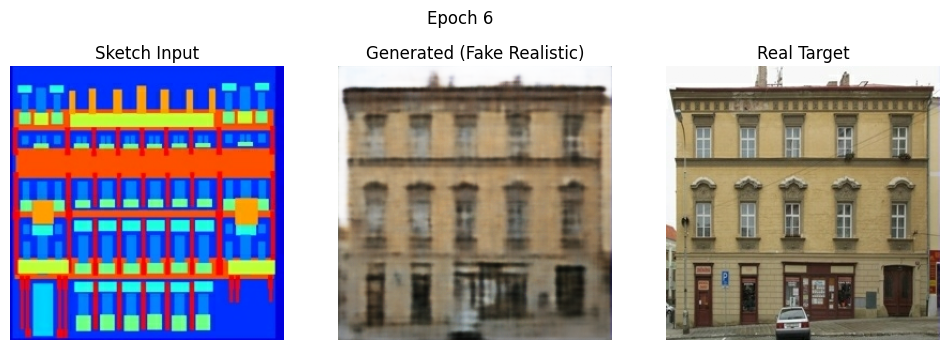


🚀 Starting Epoch 7/50
✅ Epoch 7 - Gen Loss: 13.4550, Disc Loss: 0.0019


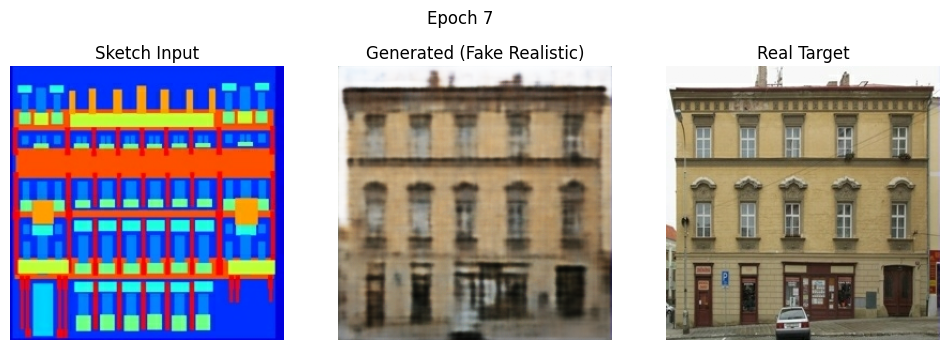


🚀 Starting Epoch 8/50
✅ Epoch 8 - Gen Loss: 13.3851, Disc Loss: 0.0018


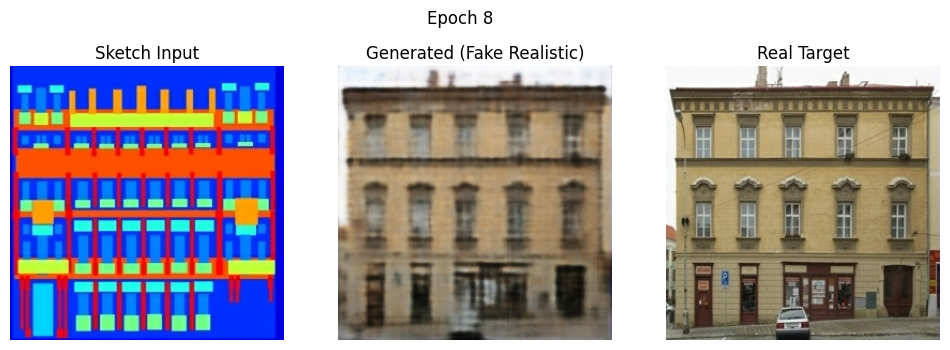


🚀 Starting Epoch 9/50
✅ Epoch 9 - Gen Loss: 13.3361, Disc Loss: 0.0014


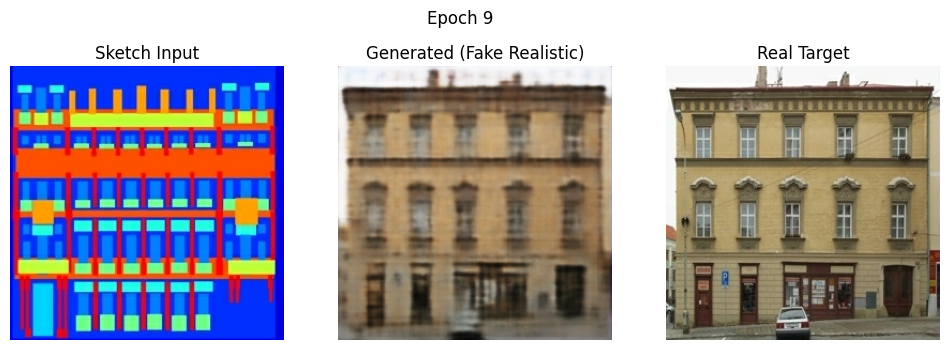


🚀 Starting Epoch 10/50
✅ Epoch 10 - Gen Loss: 13.4703, Disc Loss: 0.0016


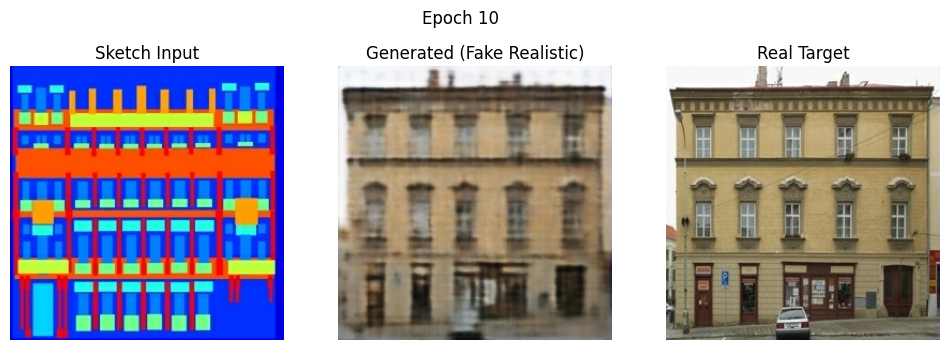


🚀 Starting Epoch 11/50
✅ Epoch 11 - Gen Loss: 13.2703, Disc Loss: 0.0015


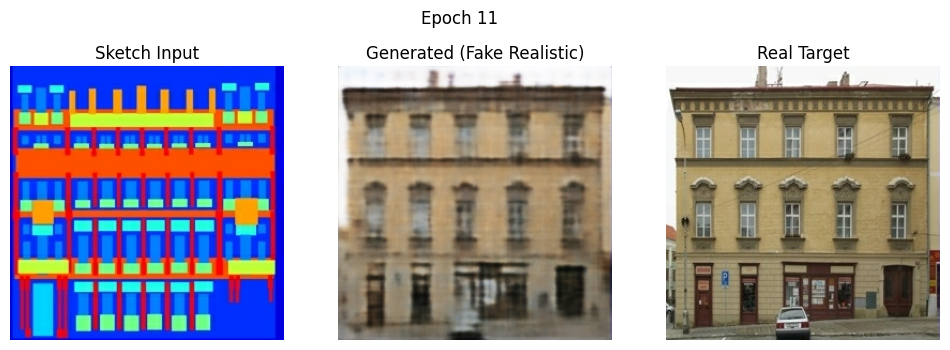


🚀 Starting Epoch 12/50
✅ Epoch 12 - Gen Loss: 13.2311, Disc Loss: 0.0013


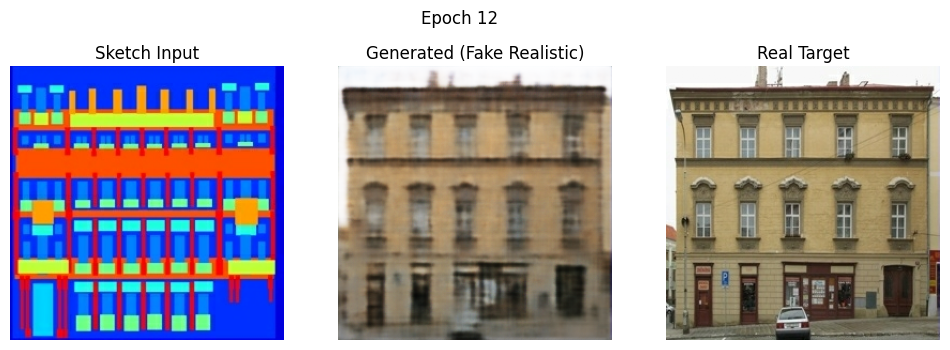


🚀 Starting Epoch 13/50
✅ Epoch 13 - Gen Loss: 13.2040, Disc Loss: 0.0011


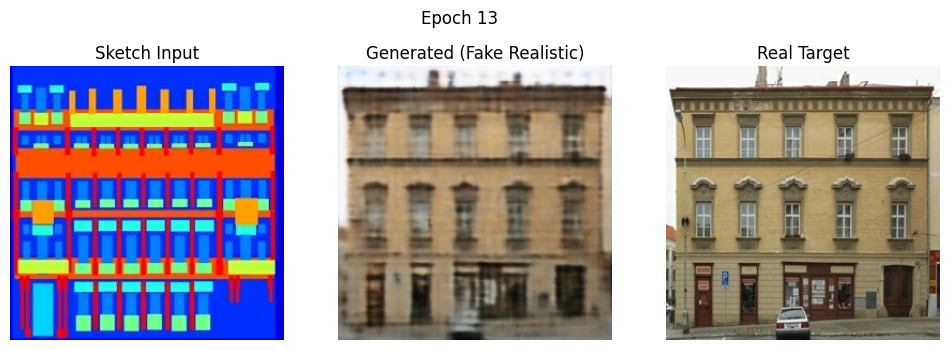


🚀 Starting Epoch 14/50
✅ Epoch 14 - Gen Loss: 13.1224, Disc Loss: 0.0014


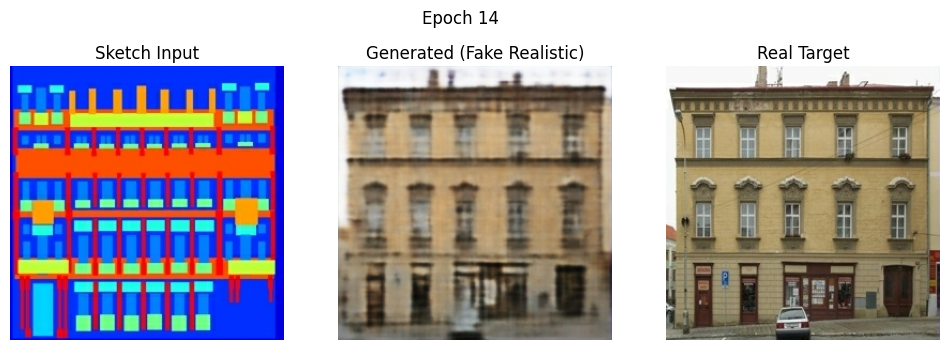


🚀 Starting Epoch 15/50
✅ Epoch 15 - Gen Loss: 12.8370, Disc Loss: 0.0012


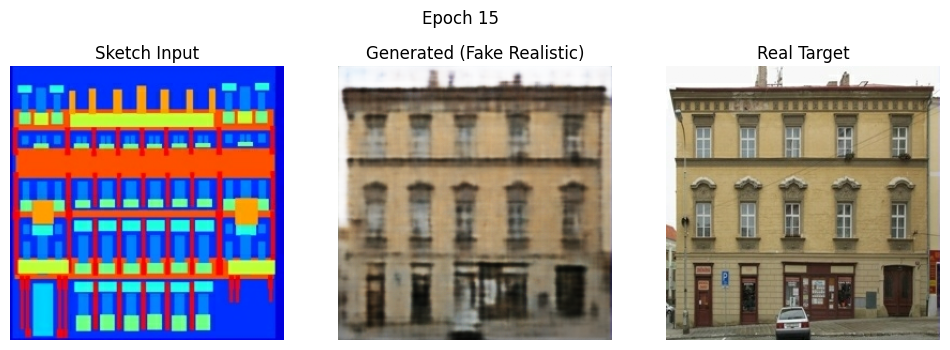


🚀 Starting Epoch 16/50
✅ Epoch 16 - Gen Loss: 12.7643, Disc Loss: 0.0011


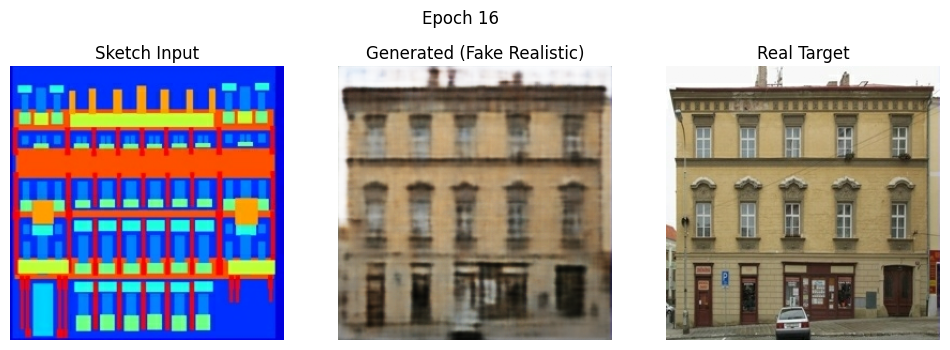


🚀 Starting Epoch 17/50
✅ Epoch 17 - Gen Loss: 12.9612, Disc Loss: 0.0010


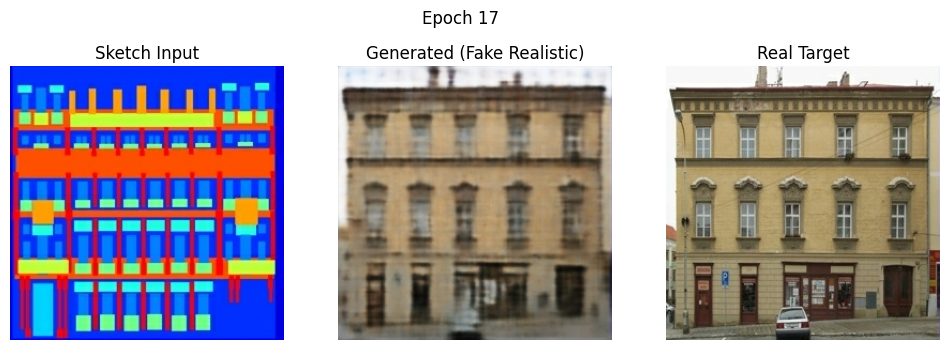


🚀 Starting Epoch 18/50
✅ Epoch 18 - Gen Loss: 12.8188, Disc Loss: 0.0012


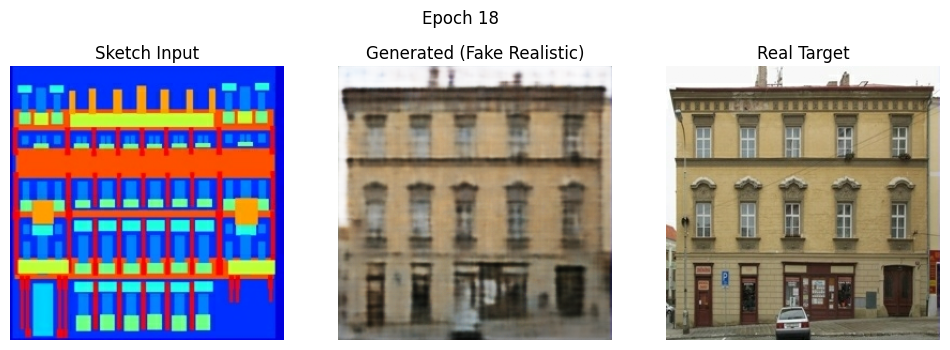


🚀 Starting Epoch 19/50
✅ Epoch 19 - Gen Loss: 12.8276, Disc Loss: 0.0010


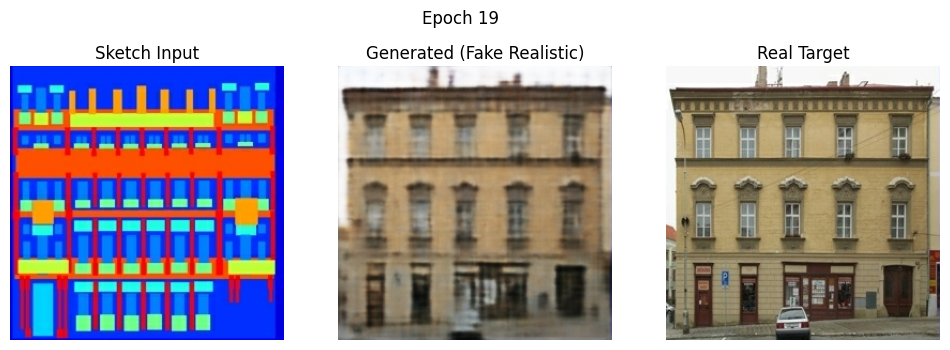


🚀 Starting Epoch 20/50
✅ Epoch 20 - Gen Loss: 12.6315, Disc Loss: 0.0009


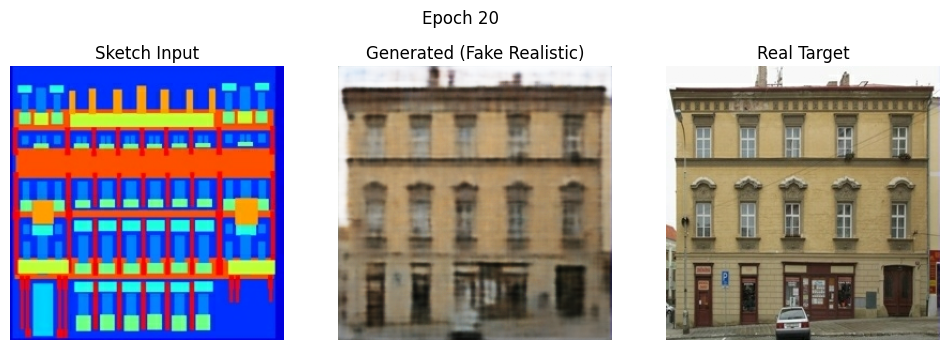


🚀 Starting Epoch 21/50
✅ Epoch 21 - Gen Loss: 12.6836, Disc Loss: 0.0009


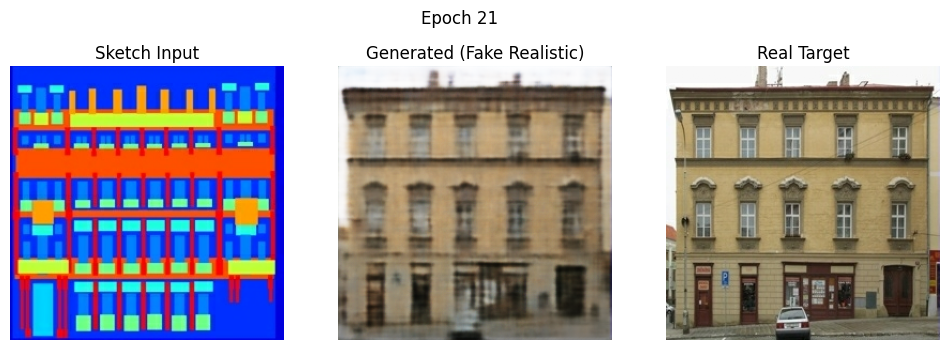


🚀 Starting Epoch 22/50
✅ Epoch 22 - Gen Loss: 12.6336, Disc Loss: 0.0012


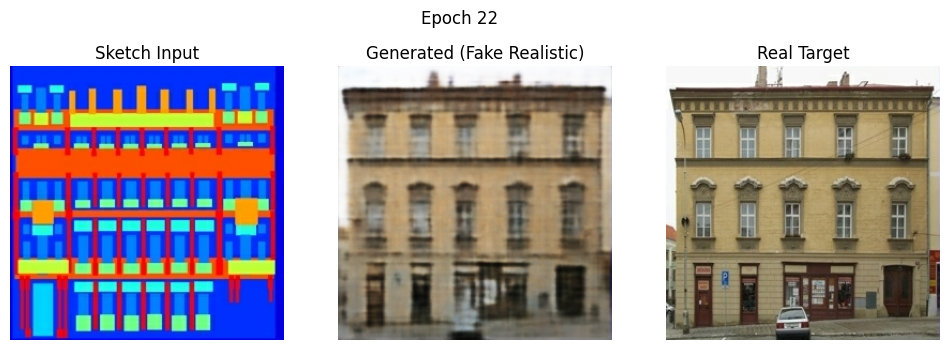


🚀 Starting Epoch 23/50
✅ Epoch 23 - Gen Loss: 12.5189, Disc Loss: 0.0011


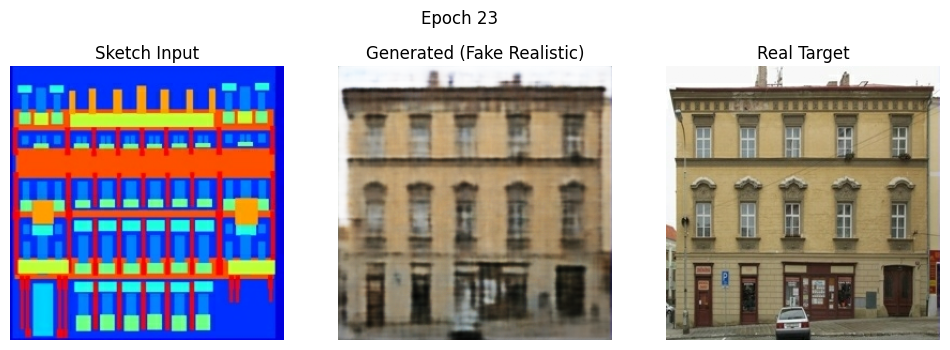


🚀 Starting Epoch 24/50
✅ Epoch 24 - Gen Loss: 12.7716, Disc Loss: 0.0009


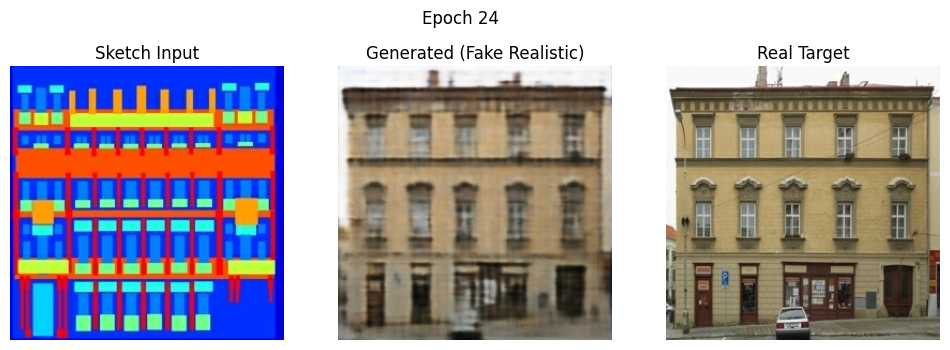


🚀 Starting Epoch 25/50
✅ Epoch 25 - Gen Loss: 12.5641, Disc Loss: 0.0009


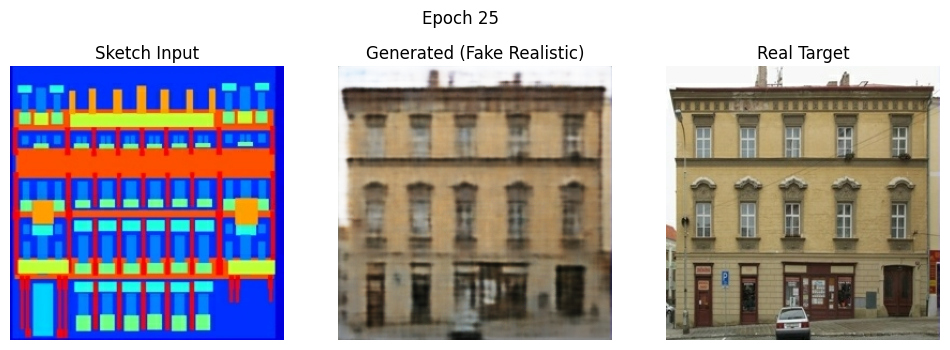


🚀 Starting Epoch 26/50
✅ Epoch 26 - Gen Loss: 12.4066, Disc Loss: 0.0007


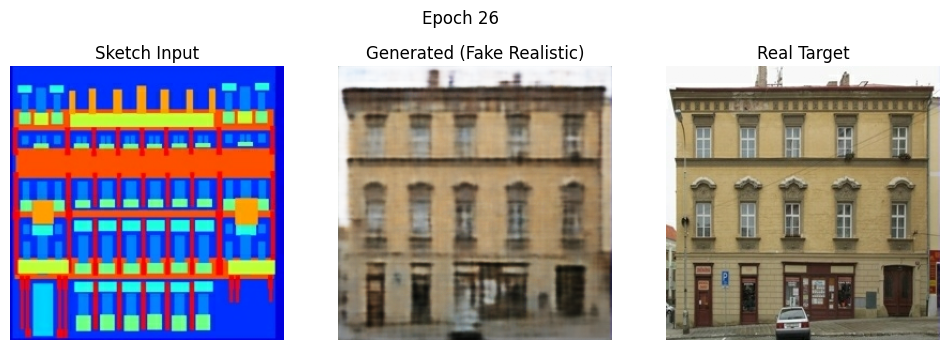


🚀 Starting Epoch 27/50
✅ Epoch 27 - Gen Loss: 12.3334, Disc Loss: 0.0008


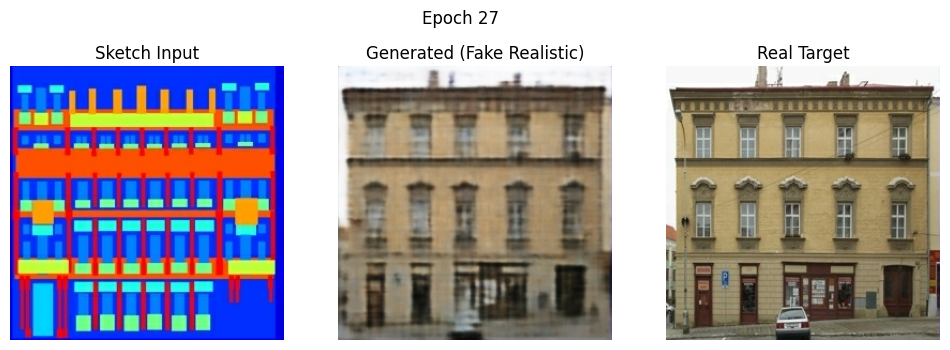


🚀 Starting Epoch 28/50
✅ Epoch 28 - Gen Loss: 12.5657, Disc Loss: 0.0014


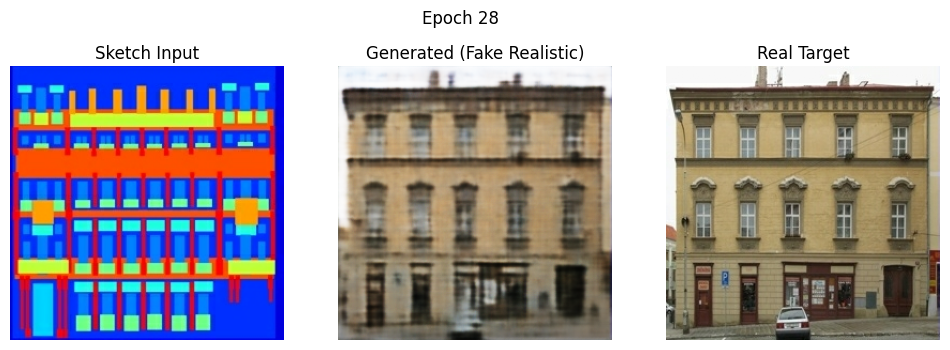


🚀 Starting Epoch 29/50
✅ Epoch 29 - Gen Loss: 12.5707, Disc Loss: 0.0009


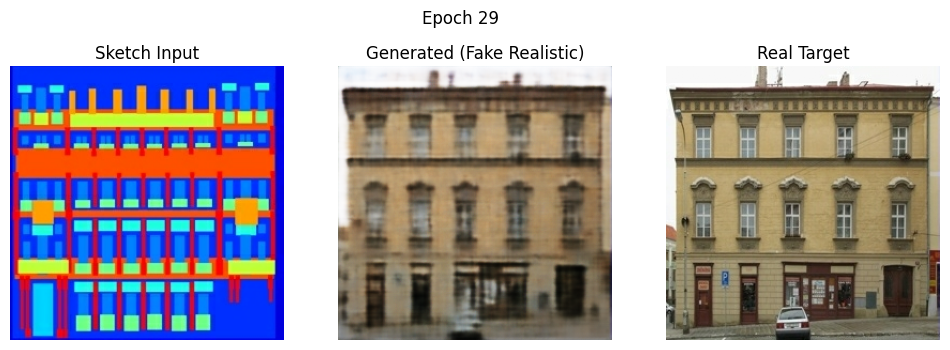


🚀 Starting Epoch 30/50
✅ Epoch 30 - Gen Loss: 12.5607, Disc Loss: 0.0008


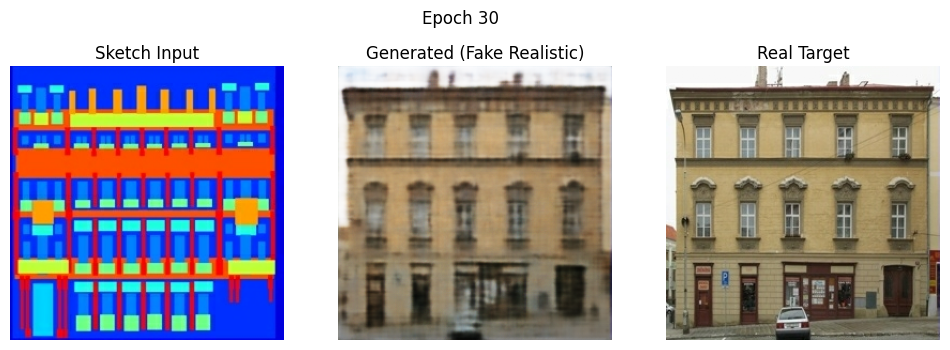


🚀 Starting Epoch 31/50
✅ Epoch 31 - Gen Loss: 12.2765, Disc Loss: 0.0007


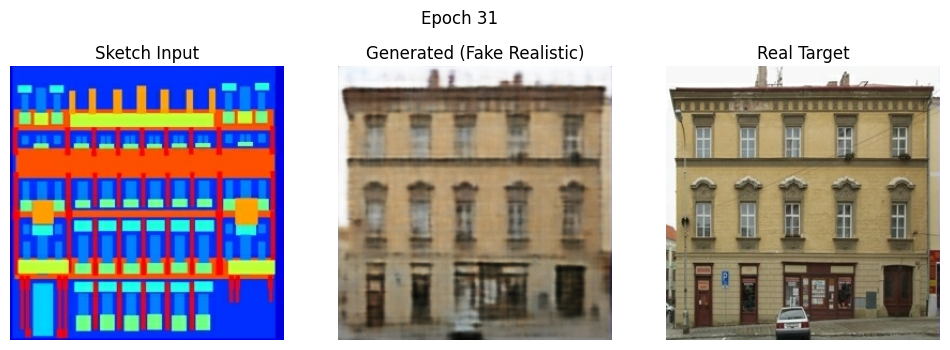


🚀 Starting Epoch 32/50
✅ Epoch 32 - Gen Loss: 12.3159, Disc Loss: 0.0007


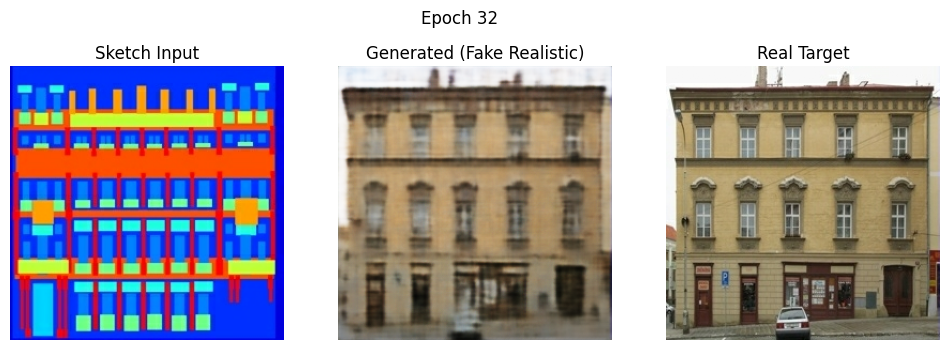


🚀 Starting Epoch 33/50
✅ Epoch 33 - Gen Loss: 12.1593, Disc Loss: 0.0009


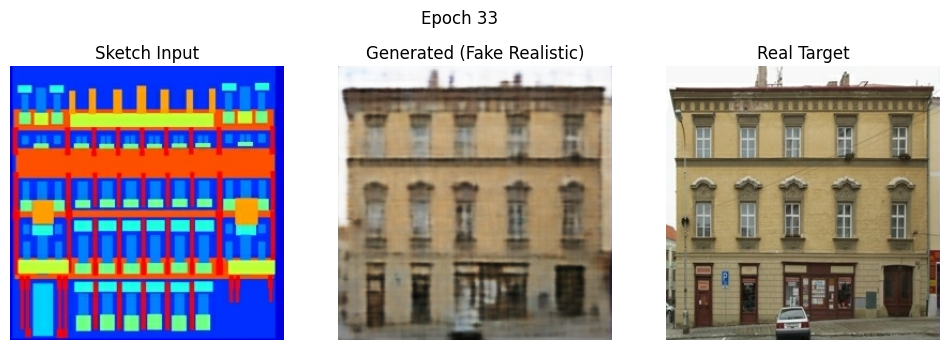


🚀 Starting Epoch 34/50
✅ Epoch 34 - Gen Loss: 12.1685, Disc Loss: 0.0009


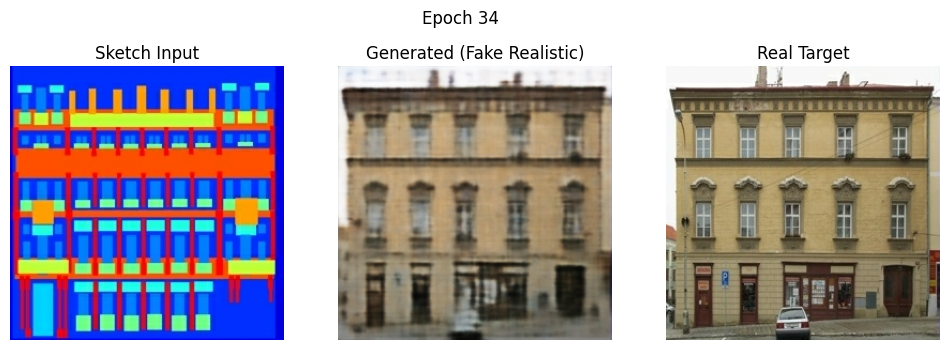


🚀 Starting Epoch 35/50
✅ Epoch 35 - Gen Loss: 12.0498, Disc Loss: 0.0010


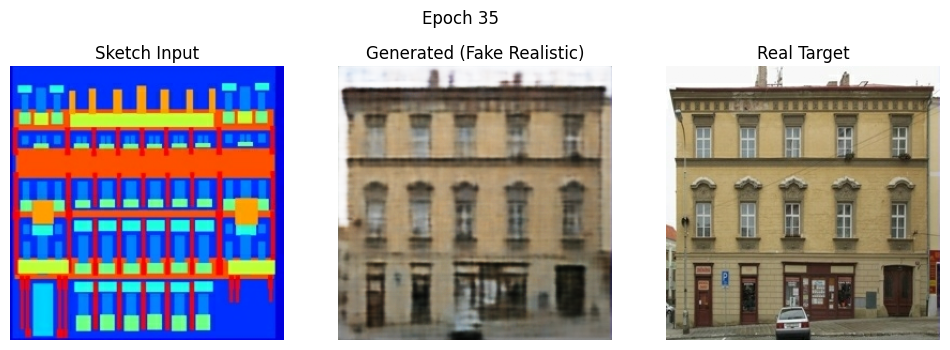


🚀 Starting Epoch 36/50
✅ Epoch 36 - Gen Loss: 12.0742, Disc Loss: 0.0009


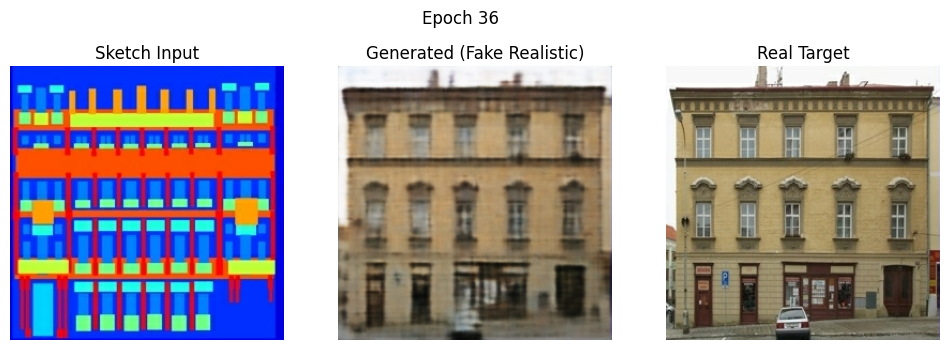


🚀 Starting Epoch 37/50
✅ Epoch 37 - Gen Loss: 11.9503, Disc Loss: 0.0011


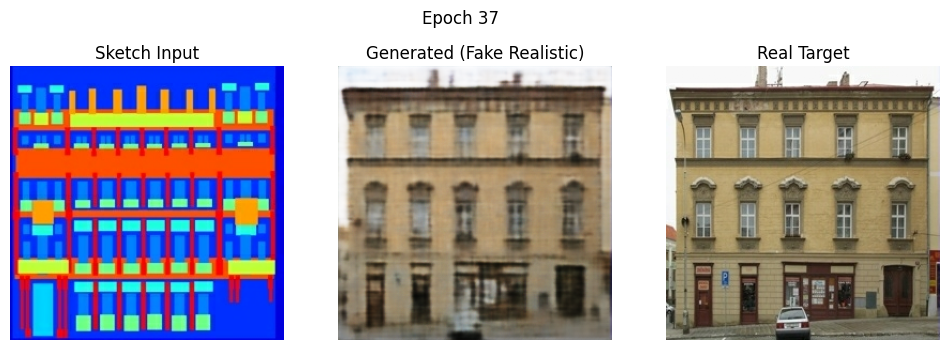


🚀 Starting Epoch 38/50
✅ Epoch 38 - Gen Loss: 11.9677, Disc Loss: 0.0005


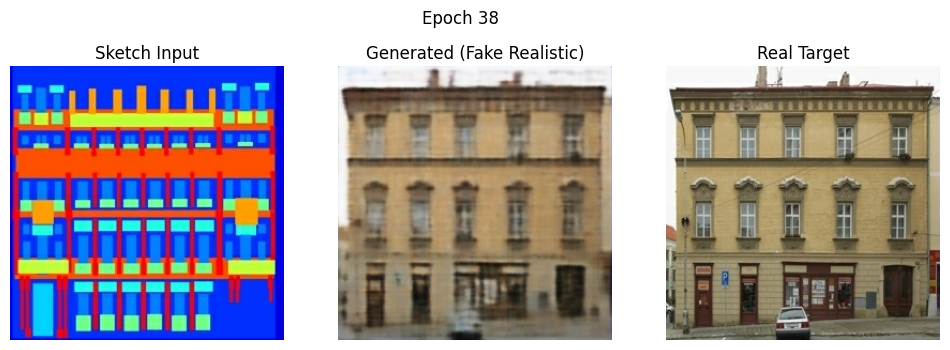


🚀 Starting Epoch 39/50
✅ Epoch 39 - Gen Loss: 11.9044, Disc Loss: 0.0006


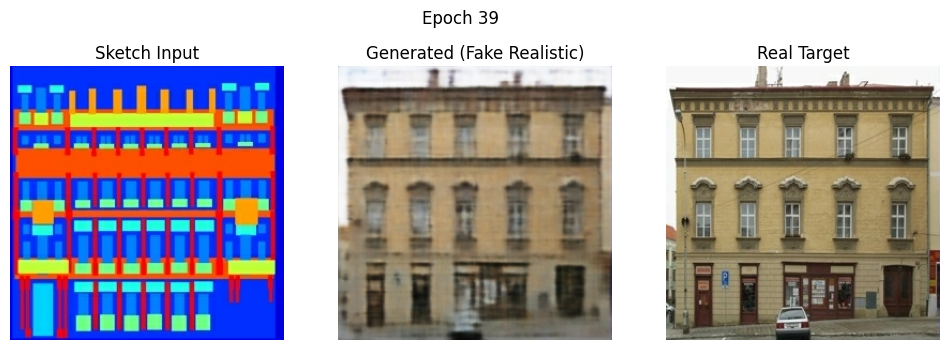


🚀 Starting Epoch 40/50
✅ Epoch 40 - Gen Loss: 11.9685, Disc Loss: 0.0005


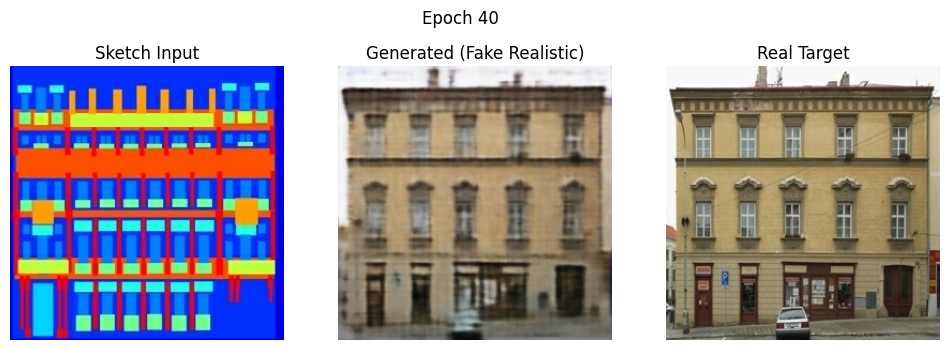


🚀 Starting Epoch 41/50
✅ Epoch 41 - Gen Loss: 12.0435, Disc Loss: 2.0533


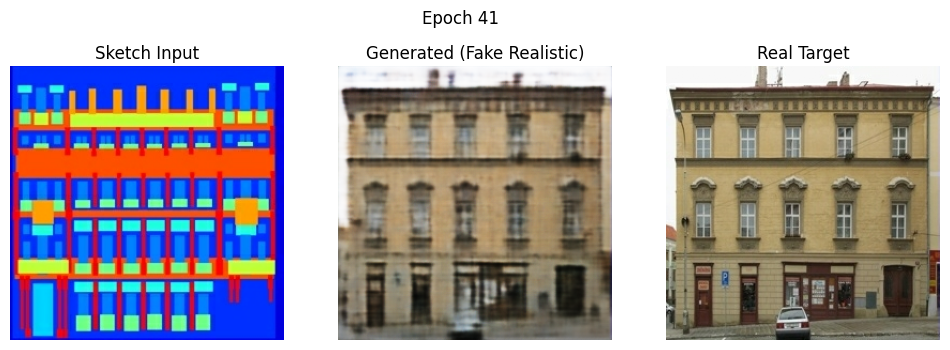


🚀 Starting Epoch 42/50
✅ Epoch 42 - Gen Loss: 11.8282, Disc Loss: 0.2687


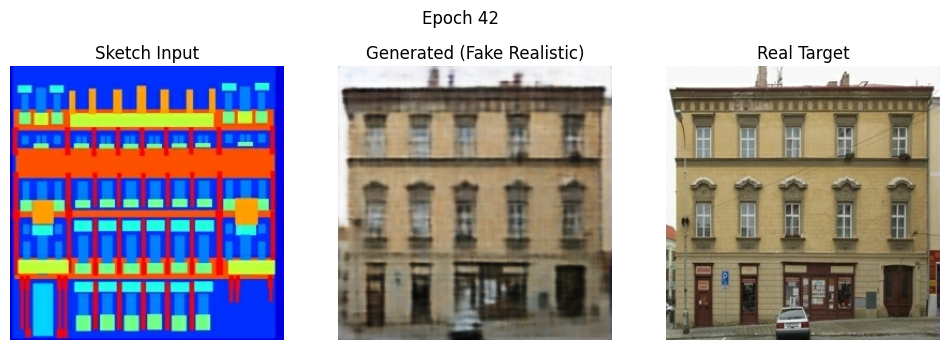


🚀 Starting Epoch 43/50
✅ Epoch 43 - Gen Loss: 11.7830, Disc Loss: 0.0935


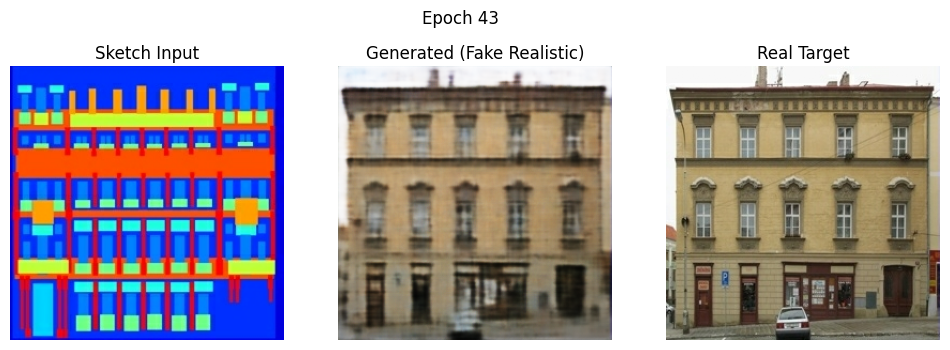


🚀 Starting Epoch 44/50
✅ Epoch 44 - Gen Loss: 11.6816, Disc Loss: 0.0398


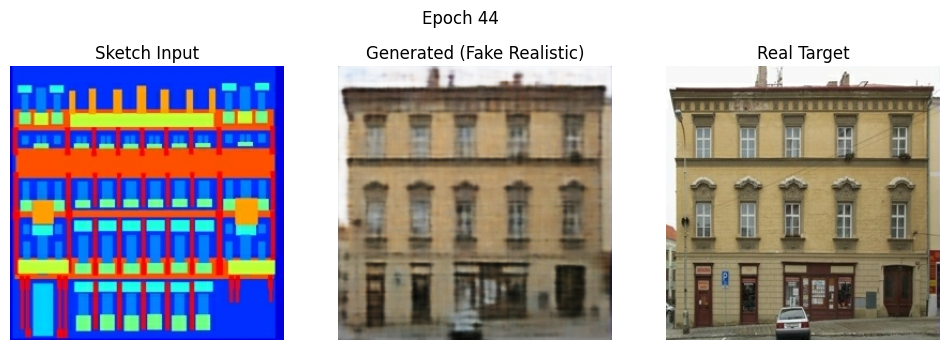


🚀 Starting Epoch 45/50
✅ Epoch 45 - Gen Loss: 11.7564, Disc Loss: 0.0236


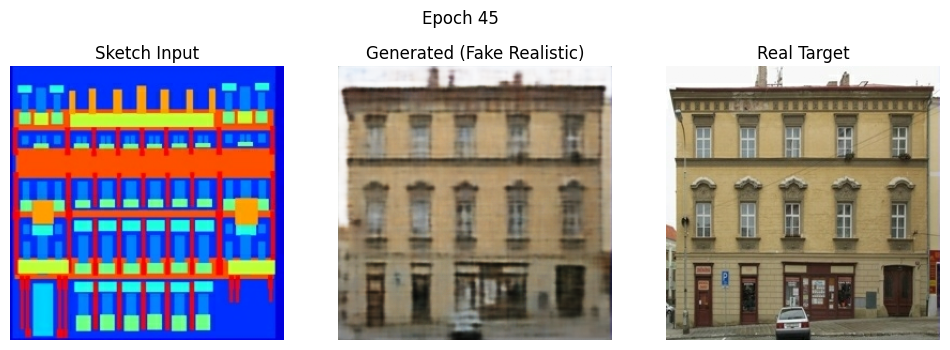


🚀 Starting Epoch 46/50
✅ Epoch 46 - Gen Loss: 11.8990, Disc Loss: 0.0159


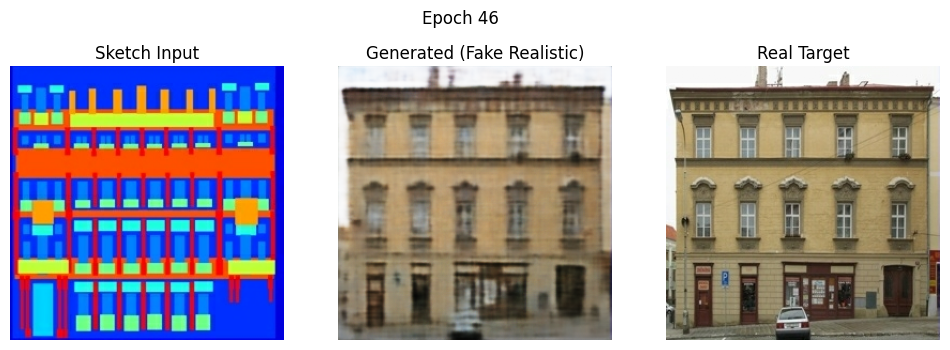


🚀 Starting Epoch 47/50
✅ Epoch 47 - Gen Loss: 11.6389, Disc Loss: 0.0118


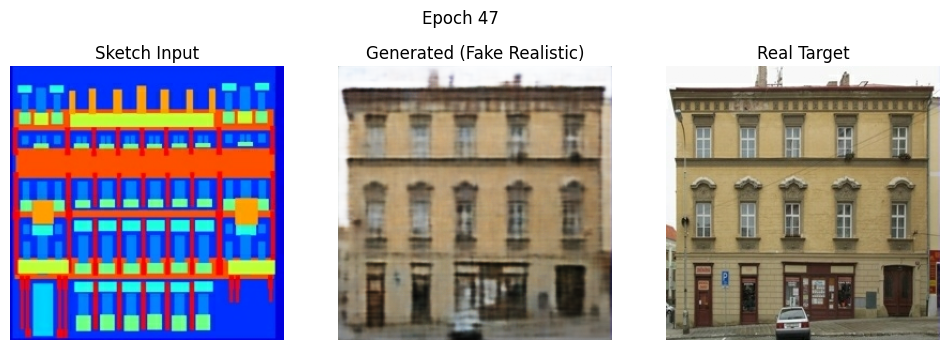


🚀 Starting Epoch 48/50
✅ Epoch 48 - Gen Loss: 11.6854, Disc Loss: 0.0077


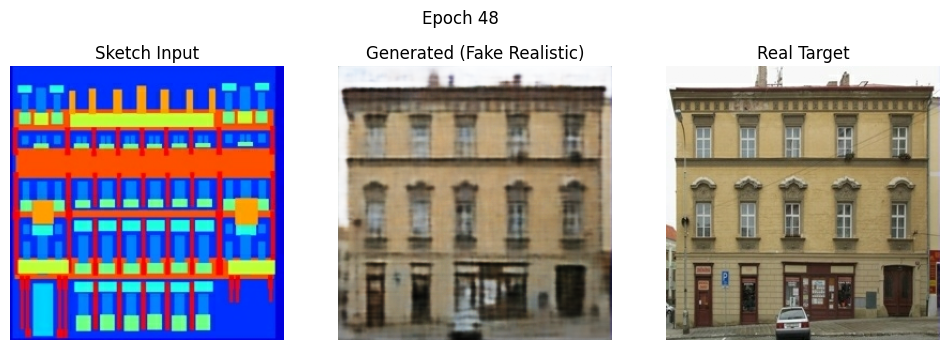


🚀 Starting Epoch 49/50
✅ Epoch 49 - Gen Loss: 11.7103, Disc Loss: 0.0043


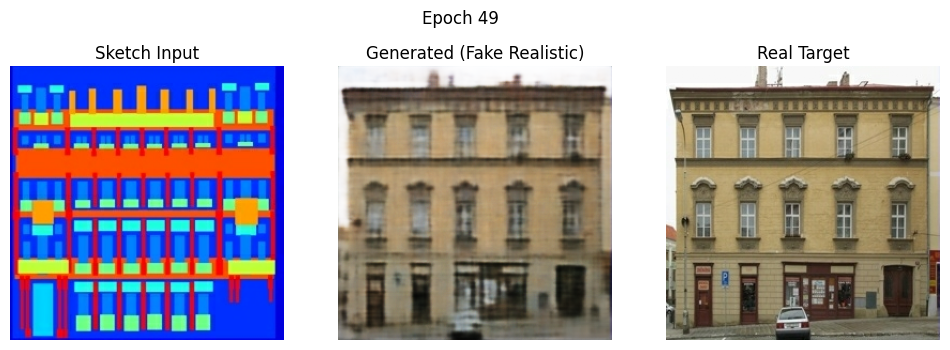


🚀 Starting Epoch 50/50
✅ Epoch 50 - Gen Loss: 11.6274, Disc Loss: 0.0033


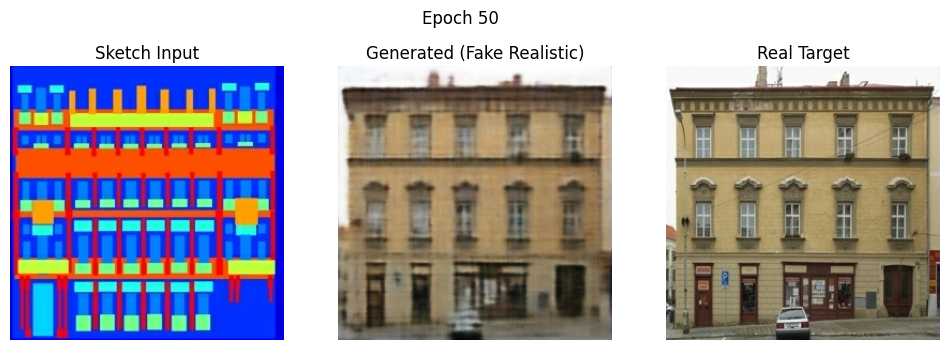

💾 Checkpoint saved at epoch 50


In [ ]:
train(train_dataset, epochs=50)


Test Set Evaluation



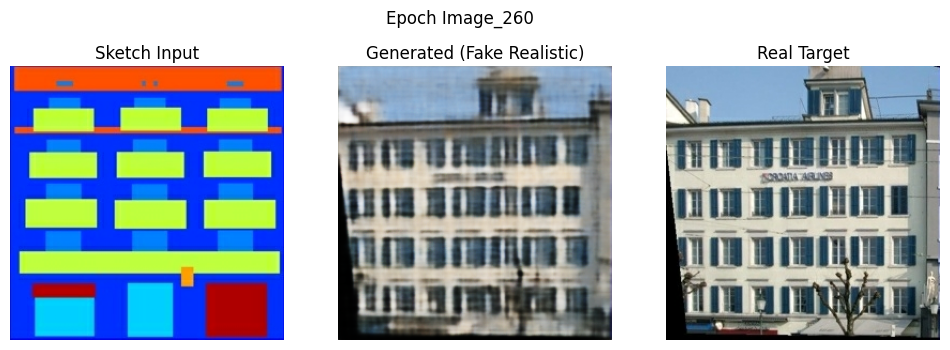

In [ ]:
# 👇 Step 1: Unbatch your dataset to access individual images
unbatched_dataset = train_dataset.unbatch().batch(1)

# 👇 Step 2: Extract the 50th sample (or change to any index)
target_index = 260
for i, (real, sketch) in enumerate(unbatched_dataset):
    if i == target_index:
        sample_real = real[0]
        sample_sketch = sketch[0]
        break
generate_and_show_sample.real_image = sample_real
# 👇 Step 3: Generate and display the output using your existing function
generate_and_show_sample(generator, sample_sketch, f"Image_{target_index}")


In [ ]:
import os
import tensorflow as tf

# Directory to save model weights
checkpoint_dir = "/content/drive/MyDrive/checkpoints"
# Create a new checkpoint object (same as before)
checkpoint = tf.train.Checkpoint(generator=generator,
                                 discriminator=discriminator,
                                 generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer)

# Restore the latest checkpoint
latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)

if latest_checkpoint:
    checkpoint.restore(os.path.join(checkpoint_dir, "ckpt-18")).expect_partial()
    print(f"✅ Restored from checkpoint: {latest_checkpoint}")
else:
    print("⚠️ No checkpoint found, starting from scratch.")

✅ Restored from checkpoint: /content/drive/MyDrive/checkpoints/ckpt-19


📊 Average Generator Loss (Test Set): 41.9128


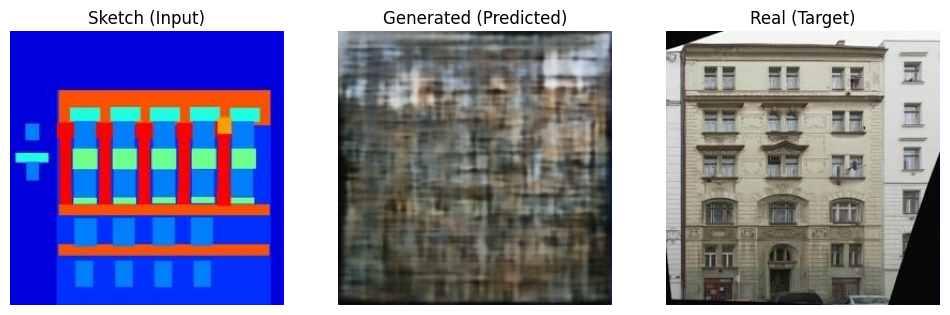

In [ ]:
import matplotlib.pyplot as plt
def preprocess_image(image, _):  # Discard label
    image = tf.image.resize(image, [256, 256])
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    return image

testA = dataset['testA'].map(preprocess_image).batch(1)
testB = dataset['testB'].map(preprocess_image).batch(1)

test_dataset = tf.data.Dataset.zip((testA,testB))
# 📉 Compute Generator Loss on Test Set
test_losses = []

for real, sketch in test_dataset:
    generated_image = generator(sketch, training=False)
    disc_generated_output = discriminator([sketch, generated_image], training=False)

    # Use your generator_loss function (which includes L1 + adversarial loss)
    gen_loss = generator_loss( generated_image, real)
    test_losses.append(gen_loss.numpy())

avg_test_loss = sum(test_losses) / len(test_losses)
print(f"📊 Average Generator Loss (Test Set): {avg_test_loss:.4f}")

# 👇 Select a test sample (e.g. 10th image)
target_index = 34
for i, (real, sketch) in enumerate(test_dataset):
    if i == target_index:
        sample_real = real[0]
        sample_sketch = sketch[0]
        break

# 👇 Generate prediction from the model
generated_image = generator(tf.expand_dims(sample_sketch, 0), training=False)[0]

# 👇 Display Sketch | Generated | Real
def display_images(sketch, generated, real):
    plt.figure(figsize=(12, 4))

    images = [sketch, generated, real]
    titles = ["Sketch (Input)", "Generated (Predicted)", "Real (Target)"]

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.imshow((images[i] + 1) / 2)  # Rescale to [0, 1]
        plt.title(titles[i])
        plt.axis("off")

    plt.show()

# 👇 Show the result
display_images(sample_sketch, generated_image, sample_real)
